<p align="center"><h1>Desborramento de imagem</h1></p>

<p align="center"><h3>Helton Wu</h3></p>
<p align="center"><h3>Matheus Borges Borba dos Santos</h3></p>
<p align="center"><h3>Vinicius</h3></p>


# Imports

In [ ]:
import numpy as np
from scipy.ndimage import gaussian_filter
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
import matplotlib.pyplot as plt
from skimage import data, color, util
from scipy.signal import convolve2d
import math
from scipy.signal import convolve2d
import scipy.optimize as opt

# Carregar imagem

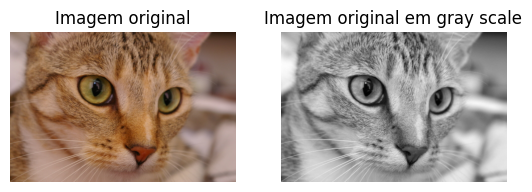

In [ ]:
img = data.chelsea()
img_gray = color.rgb2gray(img)
x_true = util.img_as_float(img_gray)

plt.subplot(1,2, 1)
plt.imshow(img)
plt.title("Imagem original")
plt.axis('off')

plt.subplot(1,2, 2)
plt.imshow(x_true, cmap='gray')
plt.title("Imagem original em gray scale")
plt.axis('off')
plt.show()

# Borrar imagem

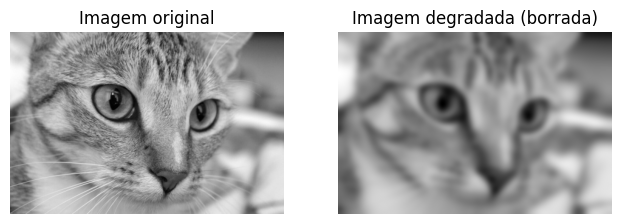

In [ ]:
gray = np.mean(img, axis=2) / 255.0

sigma = 5.0
size = int(6*sigma + 1)  # Ex: 13x13
x = np.arange(size) - size//2
xx, yy = np.meshgrid(x, x)
G = np.exp(-(xx**2 + yy**2) / (2*sigma**2))
G /= np.sum(G)
from scipy.signal import convolve2d
imagem_borrada = convolve2d(gray, G, mode='same', boundary='symm')
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title("Imagem original")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title("Imagem degradada (borrada)")
plt.axis('off')

plt.show()


# Funções necessarias + métodos

Se estamos definindo b uma amostra da imagem y borrada, temos que Ay = b
Agora supondo que queremos desborrar essa imagem, e não temos conhecimento de como ela é, então como achariamos a imagem y sem saber a cara dela? Uma solução ainda que ruidoza é min0.5*||Ax-b||, utilizando algum metodo iterativo que buscaria encontrar x que se aproxima de y.
Como gostariamos de minimizar essa diferença é possivel considerar métodos que buscam minimização como


*   Descida do Gradiente (Gd gradient descent), se considerar que
f(x+td) <= f(x), e considerar d=-grad e t um passo que ajuda a atender a desigualdade, construimos um método iterativo para minimizar o problema




## Funções auxiliares

In [ ]:
def convolucao(x, kernel):
    return convolve2d(x, kernel, mode='same', boundary='symm')

def funcao_min(x, kernel, b):
    residuo = convolucao(x, kernel) - b
    return 0.5 * np.sum(residuo**2)

def grad(x, kernel, b):
    """Calcula o gradiente A^T(A(x) - b)"""
    residuo = convolucao(x, kernel) - b
    gradiente = convolucao(residuo, kernel)
    return gradiente

## Gradiente descente

In [ ]:
def gradiente_descent(b, kernel, tol, maxiter=1000):
    guardar_x = []
    historico_grad = []

    # Chute inicial
    x = np.zeros(b.shape)
    iter = 0

    # Calcula o gradiente
    g_k = grad(x, kernel, b)
    norma_g = np.linalg.norm(g_k)
    # Salva o estado inicial
    historico_grad.append(norma_g)


    custo_anterior = funcao_min(x, kernel, b)

    print(f"Iter 0: Norma do Gradiente = {norma_g:.4e}, Custo = {custo_anterior:.4e}")

    while (iter < maxiter) and (norma_g > tol):

        #define direção de descida
        dk = -g_k
        norm_g_k_sq = norma_g**2  # reutiliza a norma e coloca ela ao quadrado

        # Aplica convolução em d, e pega a norma ao quadrado de A(d)
        Adk = convolucao(dk, kernel)
        norm_Adk_sq = np.sum(Adk**2)

        # Evitar divisão por zero se a norma for minúscula, porque temos que dividir por adk
        if norm_Adk_sq < 1e-12:
            print("Parando: Norma de A(dk) muito pequena.")
            break

        # Calcula tk otimo por busca exata
        tk = norm_g_k_sq / norm_Adk_sq

        # novo x
        x = x + tk * dk

        # novo gradiente com x atualizado
        g_k = grad(x, kernel, b)
        norma_g = np.linalg.norm(g_k) # Atualiza a condição de parada

        historico_grad.append(norma_g)


        # calcular novo custo e verificar early stopping
        custo_novo = funcao_min(x, kernel, b)

        # Verificar se o custo aumentou (sinal de instabilidade)
        if custo_novo > (custo_anterior + 1e-9): # 1e-9 é uma tolerância numérica
            print(f"\nPARAGEM ANTECIPADA (Early Stopping) na Iteração {iter+1}:")
            print(f"  Custo novo ({custo_novo:.4e}) > Custo anterior ({custo_anterior:.4e})")
            break

        # Atualiza o custo anterior para a próxima iteração
        custo_anterior = custo_novo

        # --------------------------------------------------------

        iter += 1

        if iter % 10 == 0:
            print(f"Iter {iter}: Norma do Gradiente = {norma_g:.4e}, Custo = {custo_novo:.4e}")
            guardar_x.append(x)

    print(f"\nConcluído em {iter} iterações.")
    return x, guardar_x, historico_grad

## Grad Conjulgado

In [ ]:
def grad_conjugado(b, kernel, tol, maxiter=1000):
    """
    Resolve o problema min 1/2*||Ax-b||^2 usando Gradientes Conjugados (CGNE).
    Isto é equivalente a resolver (A^T A)x = (A^T b).
    """

    x = np.zeros(b.shape)
    iter = 0
    amostras = []
    historico_grad = []
    # Configuração do Problema (A^T A)x = (A^T b)
    # Podemos calcular g = -grad(x=0, kernel, b)
    g_rhs = -grad(x, kernel, b)

    # O nosso residual inicial é r = g - (A^T A)x
    # Como x=0, o residual r_0 é igual a g
    r = g_rhs

    # A nossa primeira direção de busca é p = -r
    # Mas para CGNE padrão, a primeira direção é p = r
    p = r

    # r_old'*r_old (para o cálculo do beta)
    rs_old_sq = np.sum(r**2)
    #

    # while norm(r,2) > tol && iter < maxiter
    norma_r = np.linalg.norm(r)
    historico_grad.append(norma_r)
    print(f"Iter 0 (CG): Norma do Residual = {norma_r:.4e}")

    while (norma_r > tol) and (iter < maxiter):

        # O passo mais caro: H*p = (A^T * A) * p
        #
        Ap = convolucao(p, kernel)
        # 2. Aplicar A^T (que é a mesma convolucao, pois kernel é simétrico)
        ATAp = convolucao(Ap, kernel) # Este é o nosso H*p

        # alpha = (r'*r) / (p'*A*p); (Traduzido para H)
        # alpha = (r'*r) / (p'*H*p)
        alpha = rs_old_sq / np.sum(p * ATAp)

        # x_novo = x + alpha*p;
        x = x + alpha * p

        # r = r + alpha*A*p; (Traduzido para H e residual r_k+1 = r_k - alpha*H*p)
        r = r - alpha * ATAp

        # beta = (r'*r)/(r_old'*r_old);
        rs_new_sq = np.sum(r**2)
        beta = rs_new_sq / rs_old_sq

        # p = -r+beta*p; (No CGNE padrão, p_k+1 = r_k+1 + beta*p_k)
        p = r + beta * p

        # erro_absoluto = norm(x_novo-x); (Já temos x atualizado)

        iter += 1
        rs_old_sq = rs_new_sq # Atualiza o r_old
        norma_r = np.linalg.norm(r) # atualiza a condição de parada
        historico_grad.append(norma_r)

        if iter % 10 == 0:
            print(f"Iter {iter} (CG): Norma do Residual = {norma_r:.4e}")
            amostras.append(x)

    print(f"\nConcluído (CG) em {iter} iterações.")

    # retornando x
    return x, amostras, historico_grad

## Quasi Newton com L-BFGS

In [ ]:

amostras_lbfgs = []
historico_grad_lbfgs = []
iter_lbfgs = 0
B_GLOBAL = imagem_borrada
KERNEL_GLOBAL = G
SHAPE_GLOBAL = gray.shape

def wrapper_funcao_min(x_1d):
    x_2d = x_1d.reshape(SHAPE_GLOBAL)
    custo = funcao_min(x_2d, KERNEL_GLOBAL, B_GLOBAL)
    return custo

def wrapper_gradiente(x_1d):
    x_2d = x_1d.reshape(SHAPE_GLOBAL)
    grad_2d = grad(x_2d, KERNEL_GLOBAL, B_GLOBAL)
    return grad_2d.flatten()

def callback_lbfgs(x_k):
    global iter_lbfgs
    iter_lbfgs += 1


    x_img = x_k.reshape(SHAPE_GLOBAL)


    g_atual = grad(x_img, KERNEL_GLOBAL, B_GLOBAL)
    norma_g = np.linalg.norm(g_atual)

    historico_grad_lbfgs.append(norma_g)

    if iter_lbfgs % 10 == 0:
        print(f"Iter {iter_lbfgs} (L-BFGS): Norma Grad = {norma_g:.4e}")
        amostras_lbfgs.append(x_img)


print("Iniciando otimização L-BFGS-B...")


amostras_lbfgs = []
historico_grad_lbfgs = []
iter_lbfgs = 0


x_inicial_1d = np.zeros(B_GLOBAL.shape).flatten()


g_inicial = grad(np.zeros(B_GLOBAL.shape), KERNEL_GLOBAL, B_GLOBAL)
historico_grad_lbfgs.append(np.linalg.norm(g_inicial))
print(f"Iter 0 (L-BFGS): Norma Grad = {historico_grad_lbfgs[0]:.4e}")


resultado_opt = opt.minimize(
    fun=wrapper_funcao_min,
    x0=x_inicial_1d,
    method='L-BFGS-B',
    jac=wrapper_gradiente,
    callback=callback_lbfgs,
    options={'maxiter': 1000, 'gtol': 1e-5}
)

print(f"Mensagem do Scipy: {resultado_opt.message}")
print(f"Concluído em {iter_lbfgs} iterações.")


imagem_desborrada_lbfgs = resultado_opt.x.reshape(SHAPE_GLOBAL)
amostras_lbfgs.append(imagem_desborrada_lbfgs)

Iniciando otimização L-BFGS-B...
Iter 0 (L-BFGS): Norma Grad = 1.7029e+02
Iter 10 (L-BFGS): Norma Grad = 1.0768e-01
Iter 20 (L-BFGS): Norma Grad = 3.4287e-02
Iter 30 (L-BFGS): Norma Grad = 1.7992e-02
Iter 40 (L-BFGS): Norma Grad = 8.7735e-03
Iter 50 (L-BFGS): Norma Grad = 7.6626e-03
Iter 60 (L-BFGS): Norma Grad = 4.8041e-03
Iter 70 (L-BFGS): Norma Grad = 5.6334e-03
Iter 80 (L-BFGS): Norma Grad = 2.2837e-03
Iter 90 (L-BFGS): Norma Grad = 2.7207e-03
Iter 100 (L-BFGS): Norma Grad = 5.7605e-03
Iter 110 (L-BFGS): Norma Grad = 1.6123e-03
Iter 120 (L-BFGS): Norma Grad = 1.0812e-03
Iter 130 (L-BFGS): Norma Grad = 1.2521e-03
Iter 140 (L-BFGS): Norma Grad = 3.4885e-03
Iter 150 (L-BFGS): Norma Grad = 1.0034e-03
Iter 160 (L-BFGS): Norma Grad = 1.2298e-03
Mensagem do Scipy: CONVERGENCE: NORM OF PROJECTED GRADIENT <= PGTOL
Concluído em 162 iterações.


In [ ]:
imagem_desborrada_cg, amostras_cg, gradientes_gc = grad_conjugado(imagem_borrada, G, 1e-5, 1000)

Iter 0 (CG): Norma do Residual = 1.7029e+02
Iter 10 (CG): Norma do Residual = 1.3062e-01
Iter 20 (CG): Norma do Residual = 3.6975e-02
Iter 30 (CG): Norma do Residual = 1.7609e-02
Iter 40 (CG): Norma do Residual = 1.0978e-02
Iter 50 (CG): Norma do Residual = 7.6209e-03
Iter 60 (CG): Norma do Residual = 5.3189e-03
Iter 70 (CG): Norma do Residual = 4.0775e-03
Iter 80 (CG): Norma do Residual = 3.4452e-03
Iter 90 (CG): Norma do Residual = 2.6151e-03
Iter 100 (CG): Norma do Residual = 2.1711e-03
Iter 110 (CG): Norma do Residual = 1.8541e-03
Iter 120 (CG): Norma do Residual = 1.6881e-03
Iter 130 (CG): Norma do Residual = 1.4292e-03
Iter 140 (CG): Norma do Residual = 1.2894e-03
Iter 150 (CG): Norma do Residual = 1.0720e-03
Iter 160 (CG): Norma do Residual = 1.0108e-03
Iter 170 (CG): Norma do Residual = 8.7365e-04
Iter 180 (CG): Norma do Residual = 8.0545e-04
Iter 190 (CG): Norma do Residual = 7.0641e-04
Iter 200 (CG): Norma do Residual = 6.6783e-04
Iter 210 (CG): Norma do Residual = 6.0519e-04

# Execução dos métodos baseados em gradiente para a primeira imagem

In [ ]:
imagem_desborrada, amostras, gradientes = gradiente_descent(imagem_borrada, G, 1e-5, 1000)

Iter 0: Norma do Gradiente = 1.7029e+02, Custo = 1.4600e+04
Iter 10: Norma do Gradiente = 2.5930e-01, Custo = 5.1334e-01
Iter 20: Norma do Gradiente = 1.1221e-01, Custo = 1.8728e-01
Iter 30: Norma do Gradiente = 6.8392e-02, Custo = 1.0459e-01
Iter 40: Norma do Gradiente = 4.8158e-02, Custo = 6.9515e-02
Iter 50: Norma do Gradiente = 3.6707e-02, Custo = 5.0794e-02
Iter 60: Norma do Gradiente = 2.9417e-02, Custo = 3.9396e-02
Iter 70: Norma do Gradiente = 2.4407e-02, Custo = 3.1834e-02
Iter 80: Norma do Gradiente = 2.0770e-02, Custo = 2.6502e-02
Iter 90: Norma do Gradiente = 1.8022e-02, Custo = 2.2570e-02
Iter 100: Norma do Gradiente = 1.5877e-02, Custo = 1.9567e-02
Iter 110: Norma do Gradiente = 1.4160e-02, Custo = 1.7208e-02
Iter 120: Norma do Gradiente = 1.2757e-02, Custo = 1.5314e-02
Iter 130: Norma do Gradiente = 1.1591e-02, Custo = 1.3765e-02
Iter 140: Norma do Gradiente = 1.0606e-02, Custo = 1.2477e-02
Iter 150: Norma do Gradiente = 9.7663e-03, Custo = 1.1392e-02
Iter 160: Norma do 

# Plots da primeira imagem

/usr/local/lib/python3.12/dist-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in scalar divide
  return 10 * np.log10((data_range**2) / err)


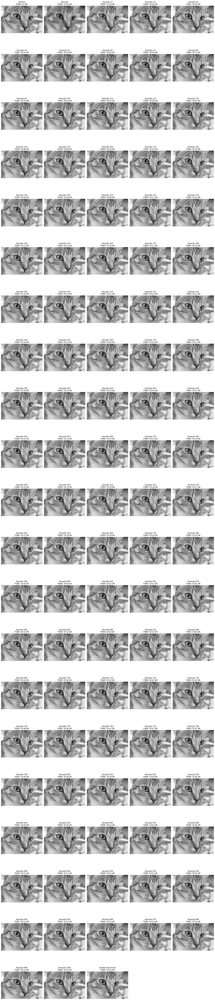

In [ ]:
n_amostras = len(amostras)


total_plots = 1 + 1 + n_amostras + 1

cols = 5

rows = math.ceil(total_plots / cols)

plt.figure(figsize=(cols * 4, rows * 4.5))


psnr_original = peak_signal_noise_ratio(gray, gray, data_range=1.0)
plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')
# Usamos \n para quebrar a linha do título
plt.title(f"Original\nPSNR: {psnr_original:.2f} dB")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')

for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras[i]
    iter_num = (i + 1) * 10


    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num}\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada, cmap='gray')
plt.title(f"Desborrada (Final)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')


plt.tight_layout()
plt.show()

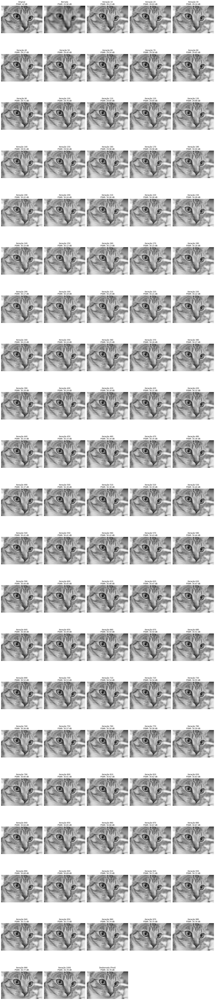

In [ ]:
n_amostras = len(amostras_cg)


total_plots = 1 + 1 + n_amostras + 1

cols = 5

rows = math.ceil(total_plots / cols)

plt.figure(figsize=(cols * 4, rows * 4.5))


psnr_original = peak_signal_noise_ratio(gray, gray, data_range=1.0)
plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')
# usamos \n para quebrar a linha do título
plt.title(f"Original\nPSNR: {psnr_original:.2f} dB")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')

for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras_cg[i]
    iter_num = (i + 1) * 10


    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num}\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada_cg, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada_cg, cmap='gray')
plt.title(f"Desborrada (Final)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')


plt.tight_layout()
plt.show()

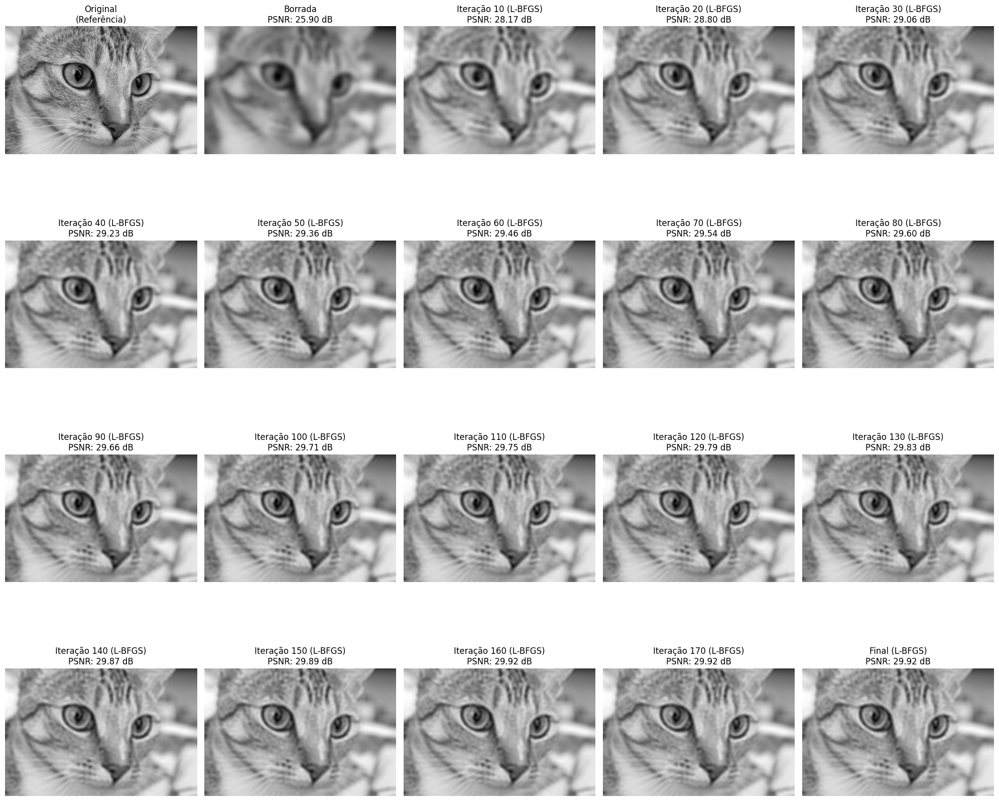

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import math
from skimage.metrics import peak_signal_noise_ratio # Certifique-se que isto está importado



n_amostras = len(amostras_lbfgs)


total_plots = 1 + 1 + n_amostras + 1


cols = 5

rows = math.ceil(total_plots / cols)

plt.figure(figsize=(cols * 4, rows * 4.5))


plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')
plt.title("Original\n(Referência)")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')


for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras_lbfgs[i]


    iter_num = (i + 1) * 10

    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num} (L-BFGS)\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada_lbfgs, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada_lbfgs, cmap='gray')
plt.title(f"Final (L-BFGS)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')

plt.tight_layout()
plt.show()

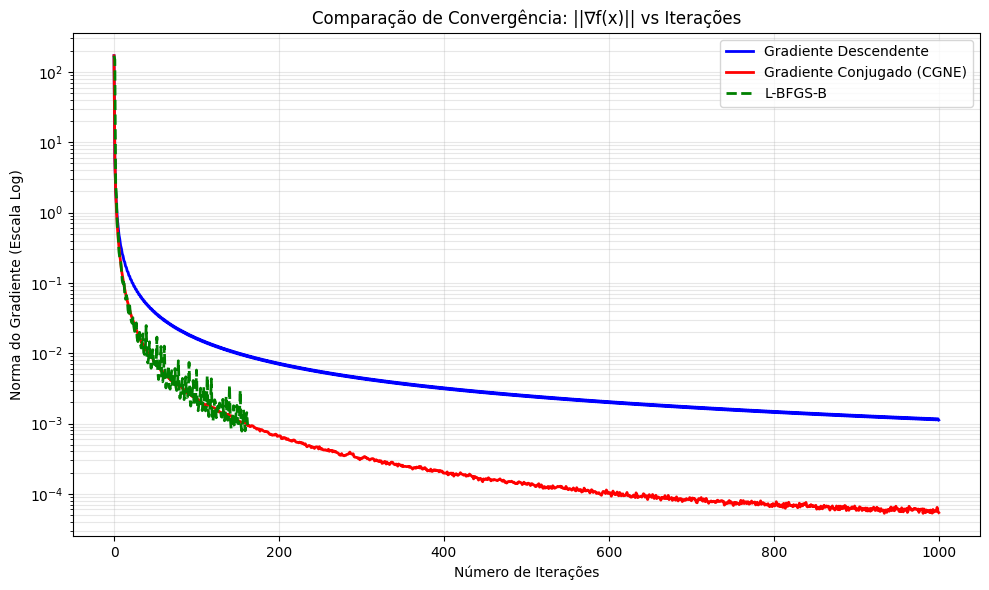

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))


plt.semilogy(range(len(gradientes)), gradientes,
             label='Gradiente Descendente', color='blue', linewidth=2)


plt.semilogy(range(len(gradientes_gc)), gradientes_gc,
             label='Gradiente Conjugado (CGNE)', color='red', linewidth=2)


plt.semilogy(range(len(historico_grad_lbfgs)), historico_grad_lbfgs,
             label='L-BFGS-B', color='green', linestyle='--', linewidth=2)

plt.title("Comparação de Convergência: ||∇f(x)|| vs Iterações")
plt.xlabel("Número de Iterações")
plt.ylabel("Norma do Gradiente (Escala Log)")
plt.legend()
plt.grid(True, which="both", ls="-", alpha=0.3)

plt.tight_layout()
plt.show()

# Carregar segunda imagem

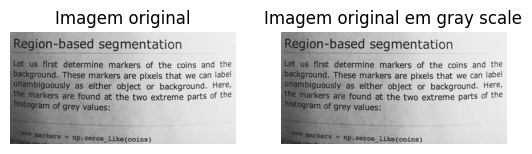

(191, 384)

In [ ]:
img = data.page()
x_true = util.img_as_float(img)
gray_float = util.img_as_float(img)
gray = gray_float


plt.subplot(1,2, 1)
plt.imshow(img, cmap='gray')
plt.title("Imagem original")
plt.axis('off')

plt.subplot(1,2, 2)
plt.imshow(x_true, cmap='gray')
plt.title("Imagem original em gray scale")
plt.axis('off')
plt.show()
x_true.shape

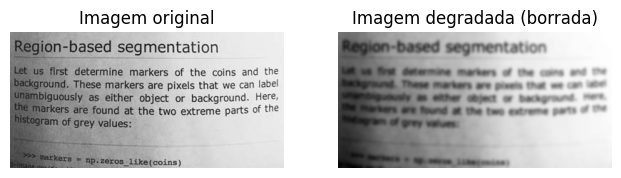

In [ ]:
sigma = 2.0
size = int(6*sigma + 1)
x = np.arange(size) - size//2
xx, yy = np.meshgrid(x, x)
G = np.exp(-(xx**2 + yy**2) / (2*sigma**2))
G /= np.sum(G)
from scipy.signal import convolve2d
imagem_borrada = convolve2d(gray, G, mode='same', boundary='symm')
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title("Imagem original")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title("Imagem degradada (borrada)")
plt.axis('off')

plt.show()


# Métodos

## Gradiente 2imagem

In [ ]:
imagem_desborrada, amostras, gradientes = gradiente_descent(imagem_borrada, G, 1e-5, 1000)

Iter 0: Norma do Gradiente = 1.8860e+02, Custo = 1.7840e+04
Iter 10: Norma do Gradiente = 2.8165e-01, Custo = 9.9140e-01
Iter 20: Norma do Gradiente = 1.5091e-01, Custo = 4.9420e-01
Iter 30: Norma do Gradiente = 1.0213e-01, Custo = 3.1607e-01
Iter 40: Norma do Gradiente = 7.6078e-02, Custo = 2.2680e-01
Iter 50: Norma do Gradiente = 5.9949e-02, Custo = 1.7457e-01
Iter 60: Norma do Gradiente = 4.9060e-02, Custo = 1.4098e-01
Iter 70: Norma do Gradiente = 4.1273e-02, Custo = 1.1788e-01
Iter 80: Norma do Gradiente = 3.5474e-02, Custo = 1.0121e-01
Iter 90: Norma do Gradiente = 3.1022e-02, Custo = 8.8687e-02
Iter 100: Norma do Gradiente = 2.7520e-02, Custo = 7.8982e-02
Iter 110: Norma do Gradiente = 2.4709e-02, Custo = 7.1257e-02
Iter 120: Norma do Gradiente = 2.2414e-02, Custo = 6.4968e-02
Iter 130: Norma do Gradiente = 2.0510e-02, Custo = 5.9751e-02
Iter 140: Norma do Gradiente = 1.8909e-02, Custo = 5.5351e-02
Iter 150: Norma do Gradiente = 1.7546e-02, Custo = 5.1587e-02
Iter 160: Norma do 

## Gradiente conjugado

In [ ]:
imagem_desborrada_cg, amostras_cg, gradiente_cg = grad_conjugado(imagem_borrada, G, 1e-5, 1000)

Iter 0 (CG): Norma do Residual = 1.8860e+02
Iter 10 (CG): Norma do Residual = 1.8724e-01
Iter 20 (CG): Norma do Residual = 5.8739e-02
Iter 30 (CG): Norma do Residual = 3.3136e-02
Iter 40 (CG): Norma do Residual = 2.2171e-02
Iter 50 (CG): Norma do Residual = 1.5979e-02
Iter 60 (CG): Norma do Residual = 1.2691e-02
Iter 70 (CG): Norma do Residual = 9.7570e-03
Iter 80 (CG): Norma do Residual = 7.9982e-03
Iter 90 (CG): Norma do Residual = 6.7984e-03
Iter 100 (CG): Norma do Residual = 5.7363e-03
Iter 110 (CG): Norma do Residual = 4.9046e-03
Iter 120 (CG): Norma do Residual = 4.2098e-03
Iter 130 (CG): Norma do Residual = 3.5519e-03
Iter 140 (CG): Norma do Residual = 3.0752e-03
Iter 150 (CG): Norma do Residual = 2.7259e-03
Iter 160 (CG): Norma do Residual = 2.4329e-03
Iter 170 (CG): Norma do Residual = 2.1885e-03
Iter 180 (CG): Norma do Residual = 1.9397e-03
Iter 190 (CG): Norma do Residual = 1.8416e-03
Iter 200 (CG): Norma do Residual = 1.7713e-03
Iter 210 (CG): Norma do Residual = 1.5955e-03

## Quasi-Newton LBFGS

In [ ]:
KERNEL_GLOBAL = G
B_GLOBAL = imagem_borrada
SHAPE_GLOBAL = B_GLOBAL.shape


amostras_lbfgs = []
historico_grad_lbfgs = []
iter_lbfgs = 0

def wrapper_funcao_min(x_1d):
    x_2d = x_1d.reshape(SHAPE_GLOBAL)
    return funcao_min(x_2d, KERNEL_GLOBAL, B_GLOBAL)


def wrapper_gradiente(x_1d):
    x_2d = x_1d.reshape(SHAPE_GLOBAL)
    return grad(x_2d, KERNEL_GLOBAL, B_GLOBAL).flatten()


def callback_lbfgs(x_k):
    global iter_lbfgs
    iter_lbfgs += 1

    x_img = x_k.reshape(SHAPE_GLOBAL)

    g_atual = grad(x_img, KERNEL_GLOBAL, B_GLOBAL)
    norma_g = np.linalg.norm(g_atual)
    historico_grad_lbfgs.append(norma_g)

    if iter_lbfgs % 10 == 0:
        print(f"Iter {iter_lbfgs} (L-BFGS): Norma Grad = {norma_g:.4e}")
        amostras_lbfgs.append(x_img)

print("Iniciando otimização L-BFGS-B...")


amostras_lbfgs = []
historico_grad_lbfgs = []
iter_lbfgs = 0


x_inicial_1d = np.zeros(B_GLOBAL.shape).flatten()

g_inicial = grad(np.zeros(B_GLOBAL.shape), KERNEL_GLOBAL, B_GLOBAL)
historico_grad_lbfgs.append(np.linalg.norm(g_inicial))
print(f"Iter 0 (L-BFGS): Norma Grad = {historico_grad_lbfgs[0]:.4e}")


resultado_opt = opt.minimize(
    fun=wrapper_funcao_min,
    x0=x_inicial_1d,
    method='L-BFGS-B',
    jac=wrapper_gradiente,
    callback=callback_lbfgs,
    options={'maxiter': 1000, 'gtol': 1e-5}
)

print(f"Mensagem do Scipy: {resultado_opt.message}")
print(f"Concluído em {iter_lbfgs} iterações.")

imagem_desborrada_lbfgs = resultado_opt.x.reshape(SHAPE_GLOBAL)
amostras_lbfgs.append(imagem_desborrada_lbfgs)

Iniciando otimização L-BFGS-B...
Iter 0 (L-BFGS): Norma Grad = 1.8860e+02
Iter 10 (L-BFGS): Norma Grad = 4.6088e-01
Iter 20 (L-BFGS): Norma Grad = 5.0655e-02
Iter 30 (L-BFGS): Norma Grad = 3.1200e-02
Iter 40 (L-BFGS): Norma Grad = 3.5540e-02
Iter 50 (L-BFGS): Norma Grad = 1.3337e-02
Iter 60 (L-BFGS): Norma Grad = 1.1708e-02
Iter 70 (L-BFGS): Norma Grad = 1.3254e-02
Iter 80 (L-BFGS): Norma Grad = 6.4495e-03
Iter 90 (L-BFGS): Norma Grad = 8.0308e-03
Iter 100 (L-BFGS): Norma Grad = 5.7350e-03
Iter 110 (L-BFGS): Norma Grad = 4.4239e-03
Iter 120 (L-BFGS): Norma Grad = 3.3990e-03
Iter 130 (L-BFGS): Norma Grad = 3.5674e-03
Iter 140 (L-BFGS): Norma Grad = 4.6728e-03
Iter 150 (L-BFGS): Norma Grad = 2.0841e-03
Iter 160 (L-BFGS): Norma Grad = 3.2498e-03
Iter 170 (L-BFGS): Norma Grad = 2.3134e-03
Iter 180 (L-BFGS): Norma Grad = 1.9010e-03
Iter 190 (L-BFGS): Norma Grad = 2.3519e-03
Iter 200 (L-BFGS): Norma Grad = 4.2655e-03
Iter 210 (L-BFGS): Norma Grad = 1.3005e-03
Iter 220 (L-BFGS): Norma Grad = 

# Plots da segunda imagem




/usr/local/lib/python3.12/dist-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in scalar divide
  return 10 * np.log10((data_range**2) / err)


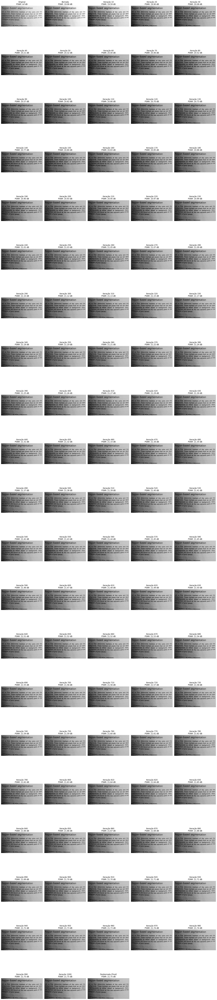

In [ ]:
n_amostras = len(amostras)


total_plots = 1 + 1 + n_amostras + 1

cols = 5

rows = math.ceil(total_plots / cols)

plt.figure(figsize=(cols * 4, rows * 4.5))


psnr_original = peak_signal_noise_ratio(gray, gray, data_range=1.0)
plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')

plt.title(f"Original\nPSNR: {psnr_original:.2f} dB")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')

for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras[i]
    iter_num = (i + 1) * 10


    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num}\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada, cmap='gray')
plt.title(f"Desborrada (Final)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')


plt.tight_layout()
plt.show()

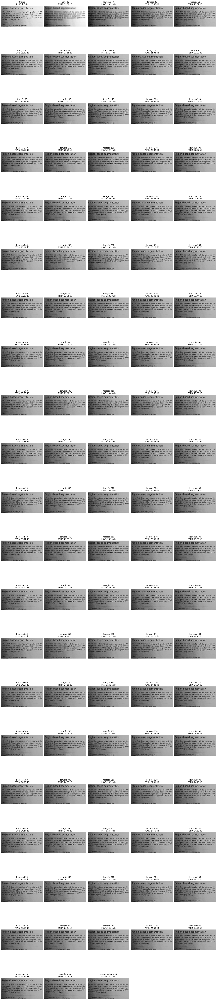

In [ ]:
n_amostras = len(amostras_cg)


total_plots = 1 + 1 + n_amostras + 1

cols = 5

rows = math.ceil(total_plots / cols)

plt.figure(figsize=(cols * 4, rows * 4.5))


psnr_original = peak_signal_noise_ratio(gray, gray, data_range=1.0)
plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')

plt.title(f"Original\nPSNR: {psnr_original:.2f} dB")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')

for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras_cg[i]
    iter_num = (i + 1) * 10


    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num}\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada_cg, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada_cg, cmap='gray')
plt.title(f"Desborrada (Final)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')


plt.tight_layout()
plt.show()

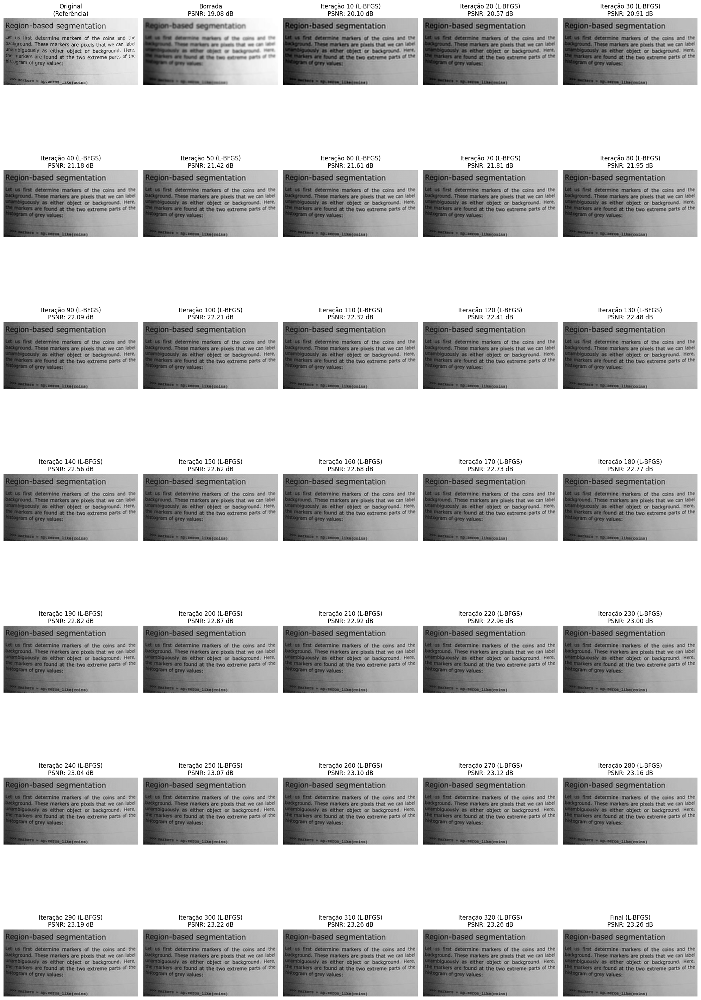

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import math
from skimage.metrics import peak_signal_noise_ratio



n_amostras = len(amostras_lbfgs)


total_plots = 1 + 1 + n_amostras + 1


cols = 5


rows = math.ceil(total_plots / cols)


plt.figure(figsize=(cols * 4, rows * 4.5))


plt.subplot(rows, cols, 1)
plt.imshow(gray, cmap='gray')
plt.title("Original\n(Referência)")
plt.axis('off')

psnr_borrada = peak_signal_noise_ratio(gray, imagem_borrada, data_range=1.0)
plt.subplot(rows, cols, 2)
plt.imshow(imagem_borrada, cmap='gray')
plt.title(f"Borrada\nPSNR: {psnr_borrada:.2f} dB")
plt.axis('off')

for i in range(n_amostras):

    plot_index = i + 3
    plt.subplot(rows, cols, plot_index)

    img_amostra = amostras_lbfgs[i]


    iter_num = (i + 1) * 10


    psnr_amostra = peak_signal_noise_ratio(gray, img_amostra, data_range=1.0)

    plt.imshow(img_amostra, cmap='gray')
    plt.title(f"Iteração {iter_num} (L-BFGS)\nPSNR: {psnr_amostra:.2f} dB")
    plt.axis('off')


psnr_final = peak_signal_noise_ratio(gray, imagem_desborrada_lbfgs, data_range=1.0)
plt.subplot(rows, cols, total_plots)
plt.imshow(imagem_desborrada_lbfgs, cmap='gray')
plt.title(f"Final (L-BFGS)\nPSNR: {psnr_final:.2f} dB")
plt.axis('off')


plt.tight_layout()
plt.show()

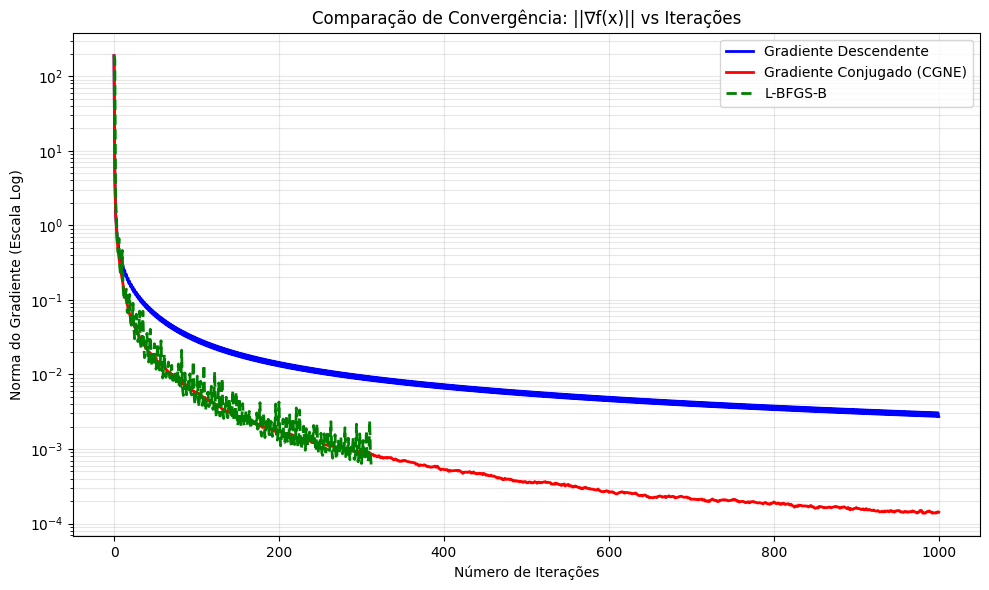

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))


plt.semilogy(range(len(gradientes)), gradientes,
             label='Gradiente Descendente', color='blue', linewidth=2)


plt.semilogy(range(len(gradiente_cg)), gradiente_cg,
             label='Gradiente Conjugado (CGNE)', color='red', linewidth=2)


plt.semilogy(range(len(historico_grad_lbfgs)), historico_grad_lbfgs,
             label='L-BFGS-B', color='green', linestyle='--', linewidth=2)


plt.title("Comparação de Convergência: ||∇f(x)|| vs Iterações")
plt.xlabel("Número de Iterações")
plt.ylabel("Norma do Gradiente (Escala Log)")
plt.legend()
plt.grid(True, which="both", ls="-", alpha=0.3)

plt.tight_layout()
plt.show()